<a href="https://colab.research.google.com/github/EduardoPatron/Advance-Numerical-Analysis/blob/main/EDP.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
import numpy as np
import matplotlib.pyplot as plt

In [2]:
from mpl_toolkits.mplot3d import Axes3D # Gráficación en 3D
from matplotlib.animation import FuncAnimation
from IPython.display import HTML # Para ver las animaciones en Colab

# Ecuaciones diferenciales parciales

Una EDP es una ecuación con más de una variable independiente. Se va a limitar el estudio a ecuaciones de segundo orden que son de la forma

$$ Au_{xx} + Bu_{xy} + Cu_{yy} + F(u_x, u_y, u, x, y) = 0 $$

Dependiendo de los términos líderes de la ecuación de arriba, la solución tiene diferentes propiedades. Las EDP de segundo orden se pueden clasificar de la siguiente forma:

* Parábolica si $B^2 - 4AC = 0$
* Hiperbolica si $B^2 - 4AC > 0$
* Elíptica si $B^2 - 4AC < 0$

# Ecuación de calor
La ecuación
$$ u_t = Du_{xx}$$
representa la temperatura $x$ medida a lo largo de un camino homogéneo unidimensional. La constante $D>0$ se conoce como el **coeficiente de difución**. La ecuación de calor representa como se exparce el color de una región con una concentración mayor a regiones con menor consentración.

Esta es una ecuación del tipo *parábolica*. ($A=D, B = 0, C = 0$)

In [3]:
D = 1 # Coeficiente de difusión

# Condición inicial
def f(x):
  return np.sin(2*np.pi*x)**2

# Condiciones de frontera en el tiempo
def l(t): # Condición izquierda
  return 0*t
def r(t): # Condición derecha
  return 0*t

# Intervalo de espacio
xl, xr = 0, 1
# Intervalo de tiempo
t0, tf = 0, 1

# Números de pasos
M = 20 # Número de pasos en el espacio
N = 800 # Número de pasos en el tiempo

h, k = (xr - xl)/M, (tf - t0)/N # Tamaños de pasos

# Constante correspondiente al sistema
sigma = D*k/h**2

## Método de diferenciación hacia el frente.

Bajo el analisis de estabilidad (Von Nuemann) de este método se tiene que, para que el método converga se tiene que satisfacer,
$$ \sigma < \frac{1}{2} $$

In [4]:
# Condición del análisis de Von Nuemann
if sigma < 1/2:
  print(f'La solución es estable: {sigma:.3}')
else:
  print(f'La solución es inestable: {sigma:.3}')

La solución es estable: 0.5


La estructura de iteración en este caso es

$$ w_{j+1} = Aw_j + s_j $$

* El error global de este método es de $O(k) + O(h^2)$

In [5]:
# Ecuaciones
Dp = (1 - 2*sigma)*np.ones(M - 2)
Ds = sigma*np.ones(M - 3)

# Matriz
A = np.diag(Dp) + np.diag(Ds, -1) + np.diag(Ds, 1)

# Condiciones de frontera
lside = l(t0 + np.ones(N))
rside = r(t0 + np.ones(N))

# Condición inicial
u0 = f(np.linspace(t0, tf, M))

# Grid solución: u
w = np.zeros((M, N))
w[:, 0] = u0        # CI Dirichtlet
w[0, :] = lside
w[-1, :] = rside

In [6]:
# Proceso iterativo
sj = np.zeros(M-2) # Vector sj
for i in range(1, N):
  sj[0], sj[-1] = lside[i], rside[i] # Valores de la frontera
  w[1:-1, i] = np.dot(A, w[1:-1,i-1]) + sigma*sj #Aproximación

### Gráfica de la solución

In [7]:
T = np.linspace(t0, tf, N) # grid en el tiempo
x = np.linspace(xl, xr, M) # grid en el espacio

X, Y = np.meshgrid(T, x)

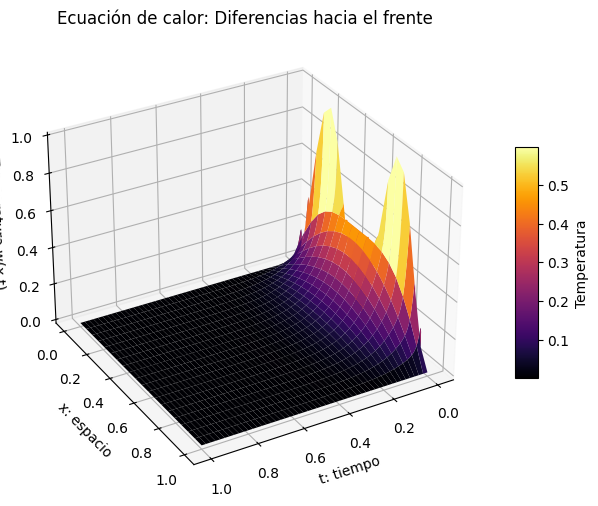

In [8]:
# Crear la figura
fig = plt.figure(figsize=(10, 6))
ax = fig.add_subplot(111, projection='3d')

# Graficar la superficie
surf = ax.plot_surface(X, Y, w, cmap='inferno')

# Etiquetas
ax.set_xlabel('t: tiempo')
ax.set_ylabel('x: espacio')
ax.set_zlabel('Temperatura w(x,t)')
ax.set_title('Ecuación de calor: Diferencias hacia el frente')

# Inclinación de la gráfica
elev = 30
azim = 60

ax.view_init(elev, azim)

# Barra de color
fig.colorbar(surf, shrink=0.5, aspect=10, label='Temperatura')

plt.show()

### Animación de la solución.
Se reliza una animación de la solución de la ecuación de calor. La animación corre sobre el tiempo y los ejes son el espacio con la temperatura en el punto.
>





In [9]:
# Base
fig, ax = plt.subplots()
ax.set_xlabel('x: espacio')
ax.set_ylabel('Temperatura')
ax.set_title('Ecuación de calor: Diferencias hacia el frente')
ax.set_xlim(xl, xr)
ax.set_ylim(bottom = 0)

# Objetos
line, = ax.plot([], [], 'r-', lw=2)

# Funciones
def init():
    line.set_data([], [])
    return line

def update(i):
    line.set_data(x, w[:,i])
    return line

# Animación
ani = FuncAnimation(fig, update, frames=len(T),
                    init_func=init, interval=20, blit=False)

# Cerrar imagen
plt.close(fig)

HTML(ani.to_jshtml())

## Método de diferenciación hacia atrás

Pare este método el análisis de estabilidad indica que es aboslutamente estable (siempre es estable). Sin embargo, el costo de este método esta en las iteraciones, la que su estructura es de la forma
$$ A w_j = w_{j-1} + \sigma s_j $$

por lo que se necesita invertir la matriz A.

* El error global de este método es de $O(k) + O(h^2)$

In [10]:
# Ecuaciones
Dp = (1 + 2*sigma)*np.ones(M - 2)
Ds = -sigma*np.ones(M - 3)

# Matriz
A = np.diag(Dp) + np.diag(Ds, -1) + np.diag(Ds, 1)

# Condiciones de frontera
lside = l(t0 + np.ones(N))
rside = r(t0 + np.ones(N))

# Condición inicial
u0 = f(np.linspace(t0, tf, M))

# Grid solución: u
w = np.zeros((M, N))
w[:, 0] = u0        # CI
w[0, :] = lside
w[-1, :] = rside

In [11]:
# Proceso iterativo
A_inv = np.linalg.inv(A) # Matrix inversa
sj = np.zeros(M-2) # Vector sj
for i in range(1, N):
  sj[0], sj[-1] = lside[i], rside[i] # Valores de la frontera
  w[1:-1, i] = np.dot(A_inv, w[1:-1,i-1] + sigma*sj) #Aproximación

### Gráfica de la solución

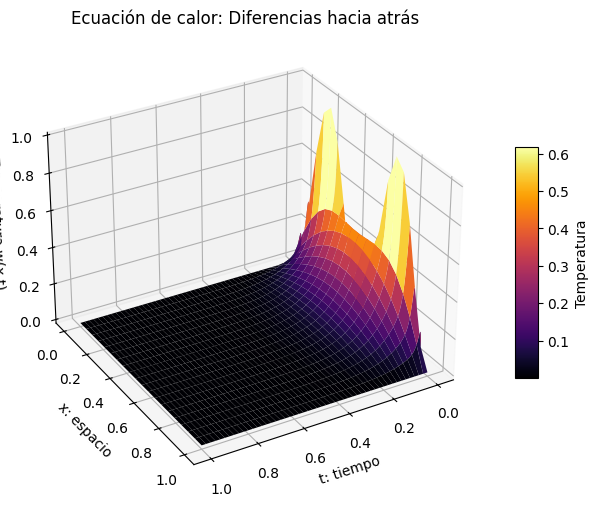

In [12]:
# Crear la figura
fig = plt.figure(figsize=(10, 6))
ax = fig.add_subplot(111, projection='3d')

# Graficar la superficie
surf = ax.plot_surface(X, Y, w, cmap='inferno')

# Etiquetas
ax.set_xlabel('t: tiempo')
ax.set_ylabel('x: espacio')
ax.set_zlabel('Temperatura w(x,t)')
ax.set_title('Ecuación de calor: Diferencias hacia atrás')

# Inclinación de la gráfica
elev = 30
azim = 60

ax.view_init(elev, azim)

# Barra de color
fig.colorbar(surf, shrink=0.5, aspect=10, label='Temperatura')

plt.show()

## Método de Crank-Nicolson
Este método combina características de los métodos anteriores. Primera mente usa la formula de diferencias hacia atrás para la derivada con respecto al tiempo y usa una combinación ponderada de la fórmulas de diferencias hacia el frente y diferencias hacia atrás para aproximar el resto de la ecuación.

Esta combinación da como resultados dos características deseables.
* El método es incondicionalmente estable.
* El error global es de $O(k^2) + O(h^2)$, merjorando con respecto a $k$ los métodos anteriores

In [13]:
# Ecuaciones
DpA = (2 + 2*sigma)*np.ones(M - 2)
DpB = (2 - 2*sigma)*np.ones(M - 2)

D = np.ones(M - 3)

# Matrices
A = np.diag(DpA) - sigma*(np.diag(D, -1) + np.diag(D, 1))
B = np.diag(DpB) + sigma*(np.diag(D, -1) + np.diag(D, 1))

# Condiciones de frontera
lside = l(t0 + np.ones(N))
rside = r(t0 + np.ones(N))

# Condición inicial
u0 = f(np.linspace(t0, tf, M))

# Grid solución: u
w = np.zeros((M, N))
w[:, 0] = u0        # CI
w[0, :] = lside
w[-1, :] = rside

En forma matricial, el método de Crack-Nicolson es

$$ Aw_j = Bw_{j-1} + \sigma(s_{j-1} + s_j) $$

In [14]:
# Proceso iterativo
A_inv = np.linalg.inv(A) # Matrix inversa
A_invB = np.dot(A_inv, B)

sj = np.zeros(M-2) # Vector sj

si = sj.copy()
si[0], si[-1] = lside[0], rside[0]

for i in range(1, N):
  sj[0], sj[-1] = lside[i], rside[i] # Valores de la frontera
  w[1:-1, i] = np.dot(A_invB, w[1:-1,i-1]) + sigma*np.dot(A_inv, si + sj) #Aproximación
  si = sj.copy()

### Gráfica de la solución

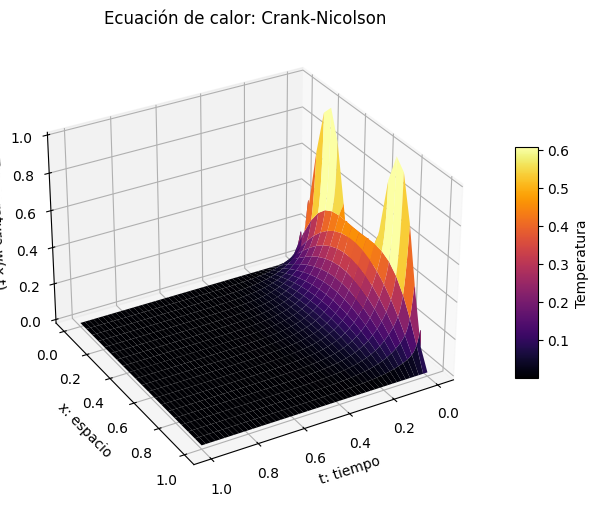

In [15]:
# Crear la figura
fig = plt.figure(figsize=(10, 6))
ax = fig.add_subplot(111, projection='3d')

# Graficar la superficie
surf = ax.plot_surface(X, Y, w, cmap='inferno')

# Etiquetas
ax.set_xlabel('t: tiempo')
ax.set_ylabel('x: espacio')
ax.set_zlabel('Temperatura w(x,t)')
ax.set_title('Ecuación de calor: Crank-Nicolson')

# Inclinación de la gráfica
elev = 30
azim = 60

ax.view_init(elev, azim)

# Barra de color
fig.colorbar(surf, shrink=0.5, aspect=10, label='Temperatura')

plt.show()

# Ecuación de onda
La ecuación
$$ u_{tt} = c^2 u_{xx} $$
representa la evolución de una onda que se propaga sobre el eje $x$. La constante $c$ representa la **velocidad de onda**.

Esta ecuación es del tipo *hiperbolica*. ($A=c^2, B = 0, C = 1$)

In [16]:
c = 2 # velocidad de onda

h = 0.05 # paso en el espacio
k = 0.025 # paso en el tiempo

# Intervalos de las variables independientes
t0, tf = 0, 1
xl, xr = 0, 1

# Cantidad de pasos
N = int((tf - t0)/k) + 1 # Numero de pasos en el tiempo
M = int((xr - xl)/h) + 1 # Numero de pasos en el espacio

def f(x): # Condición inicial en t=0
  return np.sin(np.pi*x)

def g(x): # Condición inicial de la tasa en t=0
  return 0*x

def l(t): # Condición de frontera en tiempo izq
  return 0*t

def r(t): # Condición de frontera en tiempo der
  return 0*t

## Método de diferencias finitas explícito para ecuaciones hiperbolicas.

Este método utiliza las fórmulas de diferencias centradas para expandir las parciales de segundo orden y usa la formula de tres puntos centrada para aproximar la derivada en el primer paso.

Las ecuaciones completas son de la forma
$$ w_{i, j+1} = (2-2\sigma^2)w_{ij} + \sigma^2 (w_{i-1, j} + w_{i+1,j}) - w_{i, j-1}$$

la cual no se puede utilizar para el primer paso espacial, $j=1$. Para este caso se tiene

$$ w_{i1} = (1-\sigma^2)w_{i0} + kg(x_i) + \frac{\sigma^2}{2} (w_{i-1,0} + w_{i+1,0})
$$

Las ecuaciones iterativas para este método son las siguientes:

$$ w_{1} = \frac{1}{2} A w_{0} + k g(x) + \frac{1}{2} \sigma^2 s_0$$

$$ w_{j+1} = Aw_j - w_{j-1} + \sigma^2 s_j, \quad j = 1,2,..., N $$
donde $\sigma = \frac{ck}{h}$, el cual es conocido como CFL. El método es estable cuando $\sigma \le 1$.

Consecuecia de usar las fórmulas de diferencias centras para ambas dimensiones es que el error de este método es de $O(h^2) + O(k^2)$.



In [17]:
# CFL
sigma = c*k/h

if sigma <= 1:
  print(f'El método es estable: sigma = {sigma:.3}')
else:
  print(f'El método es inestable: sigma = {sigma:.3}')

El método es estable: sigma = 1.0


In [18]:
# Tamaño de la matriz
m = M-2

# Desarrollo de la matriz A
Dp = (2 - 2*sigma**2)*np.ones(m)
Ds = sigma**2*np.ones(m-1)

A = np.diag(Dp) + np.diag(Ds, 1) + np.diag(Ds, -1)

In [19]:
# Condiciones de frontera del tiempo
T = np.linspace(t0, tf, N) # Grid en el tiempo
lside, rside = l(T), r(T)

# Condición inicial
u0 = f(np.linspace(t0, tf, M))

# Grid solución: u
w = np.zeros((M, N)) # (i, j)
w[:, 0] = u0         # CI Dirichtlet, t = 0
w[0, :] = lside
w[-1, :] = rside

In [20]:
# Primera ecuación
s = np.zeros(m)
s[0], s[-1] = w[0, 0], w[-1, 0]

w[1:-1, 1] = (1/2)*np.dot(A, w[1:-1, 0]) + k*g(np.linspace(xl, xr, m)) + (1/2)*sigma**2*s

In [21]:
# Proceso iterativo
for j in range(1, N-1):
  s[0], s[-1] = w[0,j], w[-1,j]
  w[1:-1, j+1] = np.dot(A, w[1:-1, j]) - w[1:-1, j-1] + sigma**2*s

### Gráfica de la solución

In [22]:
x = np.linspace(xl, xr, M) # grid en el espacio

X, Y = np.meshgrid(T, x)

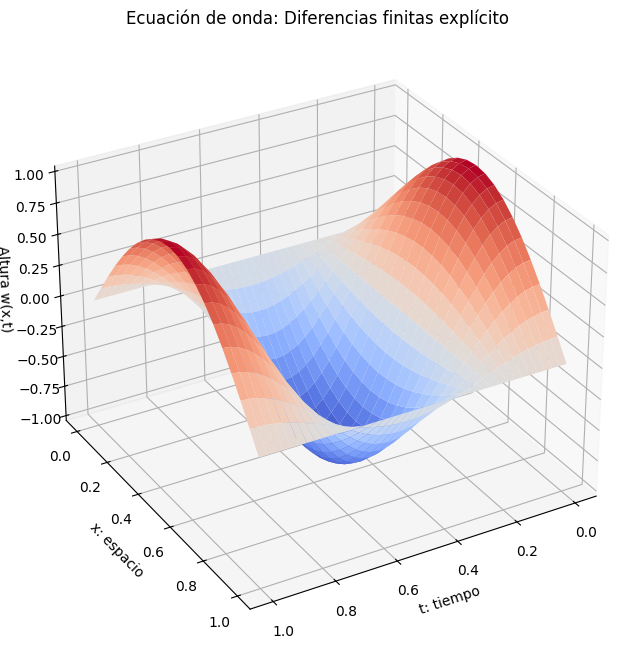

In [23]:
# Crear la figura
fig = plt.figure(figsize=(10, 8))
ax = fig.add_subplot(111, projection='3d')

# Graficar la superficie
surf = ax.plot_surface(X, Y, w, cmap='coolwarm')

# Etiquetas
ax.set_xlabel('t: tiempo')
ax.set_ylabel('x: espacio')
ax.set_zlabel('Altura w(x,t)')
ax.set_title('Ecuación de onda: Diferencias finitas explícito')

# Inclinación de la gráfica
elev = 30
azim = 60

ax.view_init(elev, azim)

plt.show()

### Animación de la solución

In [24]:
# Base
fig, ax = plt.subplots()
ax.set_xlabel('x: espacio')
ax.set_ylabel('Amplitud')
ax.set_title('Ecuación de onda: Diferencias hacia el frente')
ax.set_xlim(xl, xr)
ax.set_ylim(top = 1, bottom = -1)

# Objetos
line, = ax.plot([], [], 'r-', lw=2)

# Funciones
def init():
    line.set_data([], [])
    return line

def update(i):
    line.set_data(x, w[:,i])
    return line

# Animación
ani = FuncAnimation(fig, update, frames=len(T),
                    init_func=init, interval=20, blit=False)

# Cerrar imagen
plt.close(fig)

HTML(ani.to_jshtml())

# Ecuación de Poisson

Las *ecuaciones elipticas* modelan _estados estables_. Como por ejemplo, el estado estable de la distribucción de calor. Como el tiempo no es usualmente un factor en este tipo de modelos, se usan $x$ y $y$ como las variables independientes.

Dado una función $u$ dos veces diferenciables, se define el Laplaciano como
$$ \triangle u = ∇ \cdot \nabla u  = u_{xx} + u_{yy} $$

Para una función continua $f(x,y)$, la ecuación diferencial parcial
$$ \triangle u(x,y) = f(x,y) $$

es conocida como la **Ecuación de Poisson**. Además, si $f = 0$, entonces se conoce como la **Ecuación de Laplace**. Las soluciones se conocen como funciones armónicas.


## Método de diferencias finitas explícito.

Consideremos la ecuación de Poisson $\triangle u = f$ en el rectángulo $[x_l, x_r] \times [y_b, y_t]$ con condiciones de frontera de Dirichlet. Utilizando las fórmulas de **diferencias centradas** para ambas segundas derivadas del operador Laplaciano.

La aproximación lineal es de la forma
$$
\frac{w_{i-1, j} - 2w_{ij} + w_{i+1,j}}{h^2} + \frac{ w_{i,j-1} - 2w_{ij} + w_{i, j+1} }{k^2} = f(x_i, y_i)
$$

donde $x_i = x_l + (i-1)h$ y $y_i = y_b + (j-1)k$ para $1\le i\le m$ y $1\le j\le n$.

## Solución de la ecuación de Laplace

In [25]:
# Solución de una ecuación de Laplace

# Número de pasos
m, n = 5, 5

M, N = m-1, n-1

# Intervalo
xl, xr = 0, 1
yb, yt = 1, 2

# Condiciones de frontera de Dirichlet
def g1(x):
  return np.log(x**2 + 1)

def g2(x):
  return np.log(x**2 + 4)

def g3(y):
  return 2*np.log(y)

def g4(y):
  return np.log(y**2 + 1)

# Termino fuente
def f(x,y):
  return 0

En constraste a los métodos anteriores, la aproximación depende de los valores cercanos sobre la coordenada $x$ y, también, sobre la coordenada $y$. Por lo tanto, es conveniente realizar un __cambio de numeración__ para facilitar la implemetación de operaciones. Se define al vector $v$ de $nm$ elementos relacionado con la matriz $w$ por

$$ v_{i+(j-1)m} = w_{ij} $$

de modo que podemos extraer los coeficientes de $v$.

In [26]:
# Tamaños de paso
h, k = (xr - xl)/M, (yt - yb)/N

x = np.linspace(xl, xr, m)
y = np.linspace(yb, yt, n)

#### Matriz
Como nota esta tipo de matrices tienden a ser dispersas, de modo que es conveniente utilizar funciones del paquete _sparse_ de la libreria _scipy_  para optimiar las operaciones máquina y, de esa manera, reducir el tiempo de ejecución.

In [27]:
A = np.eye(m*n) # Matriz de coeficientes, ya cuenta con los coef de frontera
b = np.zeros(m*n) # Vector (condiciones de frontera)

# Puntos interiores
for i in range(1, m-1):
  for j in range(1, n-1):
    idx = i + j*m
    A[idx, idx] = -2/h**2 - 2/k**2 #Diagonal principal
    A[idx, idx - 1] = 1/h**2
    A[idx, idx + 1] = 1/h**2
    A[idx, idx - m] = 1/k**2
    A[idx, idx + m] = 1/k**2
    b[idx] = f(x[i], y[j])

In [28]:
for i in range(0, m):
  b[i], b[i + (n-1)*m] = g1(x[i]), g2(x[i])

In [29]:
for j in range(1, n-1):
  b[j*m], b[(m-1) + j*m] = g3(y[j]), g4(y[j])

In [30]:
v = np.linalg.solve(A, b)

In [31]:
w = v.reshape(m,n)

### Solución exacta

In [32]:
def sol(x,y):
  return np.log(x**2 + y**2)

u = np.zeros((n,m))

for i in range(0, m):
  for j in range(0, n):
    u[i,j] = sol(x[i], y[j])

### Gráfica de la solución

In [33]:
X, Y = np.meshgrid(x, y)

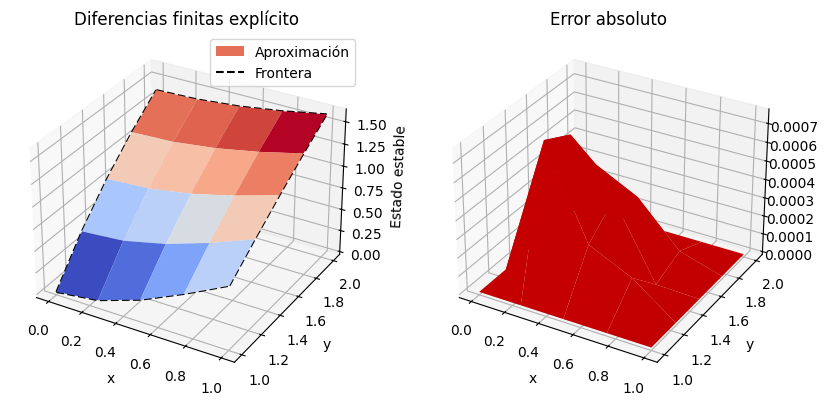

In [34]:
# Crear la figura
fig = plt.figure(figsize=(10, 8))
ax1 = fig.add_subplot(121, projection='3d')

# Graficar la superficie
ax1.plot_surface(X, Y, w, cmap='coolwarm', label = 'Aproximación')

# Condiciones de frontera
ax1.plot(x, yb, g1(x), '--', color = 'black', label = 'Frontera')
ax1.plot(x, yt, g2(x), '--', color = 'black')
ax1.plot(xl, y, g3(y), '--', color = 'black')
ax1.plot(xr, y, g4(y), '--', color = 'black')

# Etiquetas
ax1.set_xlabel('x')
ax1.set_ylabel('y')
ax1.set_zlabel('Estado estable')
ax1.set_title('Diferencias finitas explícito')

ax1.legend()

# Gráfica de los errores
ax2 = fig.add_subplot(122, projection='3d')

ax2.plot_surface(X,Y, np.abs(w- u.T), color = 'red')

# Etiquetas
ax2.set_xlabel('x')
ax2.set_ylabel('y')
ax2.set_title('Error absoluto')

plt.show()